From previous analysis, we can see that most recordings consist of multiple instances of birdsong, as well as sections of where there is no birdsong. Here, we will use Yamnet to clean our data. The steps are as follows:

using 2 classes with the most samples:
- preclean with yammnet, convert to 5s chunks
- convert to tf dataset
- test performance with yammnet finetune model
- test with spectrogram model + augment
- test leafaudio

In [1]:
import tensorflow as tf
import tensorflow_hub as hub
import numpy as np
import csv
import pandas as pd
import matplotlib.pyplot as plt
from IPython.display import Audio
from pathlib import Path

import tensorflow_io as tfio
from tqdm import tqdm
import soundfile as sf

from sklearn.model_selection import train_test_split
from functools import partial

from data import fetch_metadata,load_wav_for_map, load_wav_16k_mono, bird_mapping_idx_to_name, align, loudness_normalization
from yamnet import Yamnet

%matplotlib inline
%reload_ext autoreload
%autoreload 2

#### Identify the 2 classes we want to use:

In [2]:
birdsong_metadata = fetch_metadata()

In [3]:
print(f"the 2 classes used for this investigation:\n")
print(list(birdsong_metadata.label_string.value_counts().head(2).index.values))

print("")
print("number of recordings per class:\n")
print(list(birdsong_metadata.label_string.value_counts().head(2)))

the 2 classes used for this investigation:

['eurasian_blackcap', 'great_tit']

number of recordings per class:

[1030, 898]


In [4]:
birdsong_metadata_subset = birdsong_metadata[birdsong_metadata.label_string.isin(['eurasian_blackcap', 'great_tit'])]
assert birdsong_metadata_subset.shape[0] == birdsong_metadata.label_string.value_counts().head(2).sum()

In [5]:
birdsong_metadata_subset.loc[:, 'label'] = birdsong_metadata_subset.label_string.apply(lambda x: 1 if x=='great_tit' else 0)

In [6]:
birdsong_metadata_subset.head()

,id,gen,sp,ssp,en,rec,cnt,loc,lat,lng,...,playback-used,mergename,genus,species,ebird_code,download_url,label_string,label,filepath,valid
3868,634622,Parus,major,NaN,Great Tit,Jorge Leitão,Germany,"Langgewann, Heidelberg, Baden-Württemberg, DE",49.4218,8.6781,...,no,Parus major,Parus,major,gretit1,https://www.xeno-canto.org/634622/download,great_tit,1,/media/wwymak/Storage2/birdsong_dataset/xeno_c...,True
3869,633254,Parus,major,NaN,Great Tit,Stanislas Wroza,France,"Saint-Pierre, Jura, Bourgogne-Franche-Comté",46.5529,5.9105,...,no,Parus major,Parus,major,gretit1,https://www.xeno-canto.org/633254/download,great_tit,1,/media/wwymak/Storage2/birdsong_dataset/xeno_c...,True
3870,632658,Parus,major,NaN,Great Tit,Jacobo Ramil MIllarengo,Spain,"Fraga de Quiroga, Catasós, Lalín, Galicia",42.6360,-8.0898,...,no,Parus major,Parus,major,gretit1,https://www.xeno-canto.org/632658/download,great_tit,1,/media/wwymak/Storage2/birdsong_dataset/xeno_c...,True
3871,631839,Parus,major,NaN,Great Tit,Marcin Urbański,Poland,"Nowy Sącz, Nowy Sącz, Małopolskie",49.6098,20.7297,...,no,Parus major,Parus,major,gretit1,https://www.xeno-canto.org/631839/download,great_tit,1,/media/wwymak/Storage2/birdsong_dataset/xeno_c...,True
3872,631828,Parus,major,NaN,Great Tit,Jordi Calvet,Spain,"Navàs, El Bages, Catalunya",41.9109,1.7956,...,no,Parus major,Parus,major,gretit1,https://www.xeno-canto.org/631828/download,great_tit,1,/media/wwymak/Storage2/birdsong_dataset/xeno_c...,True


#### Precleaning

First, let's have an understanding of how the precleaning can be done using some examples

In [7]:
examples = birdsong_metadata_subset.sample(n=3, random_state=101)
examples = examples[['id', 'label_string', 'filepath']]
examples

,id,label_string,filepath
9165,214657,eurasian_blackcap,/media/wwymak/Storage2/birdsong_dataset/xeno_c...
3918,619362,great_tit,/media/wwymak/Storage2/birdsong_dataset/xeno_c...
4734,131590,great_tit,/media/wwymak/Storage2/birdsong_dataset/xeno_c...


We can see in the below the chunks we would like to remove/separate

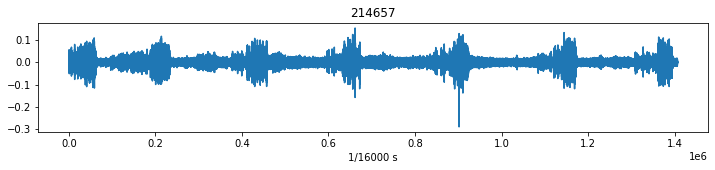

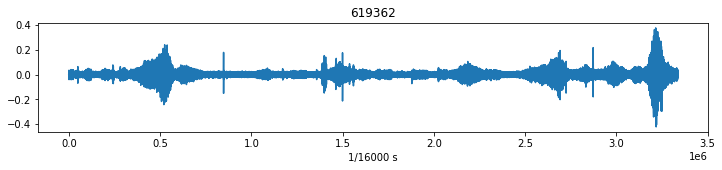

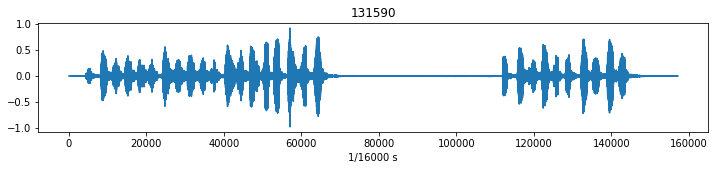

In [8]:
waveforms = {}
for idx, row in examples.iterrows():
    waveform = load_wav_16k_mono(row['filepath'])
    waveforms[row['id']] = waveform
    plt.figure(figsize=(12, 2))
    plt.plot(waveform)
    plt.xlabel('1/16000 s')
    plt.title(row['id'])



We're going to need the yamnet model, so load that in, and get the indices of birdsong related classes:

In [9]:
yamnet_base = Yamnet()
yamnet_class_names = yamnet_base.yamnet_class_names

bird_indices = [idx for idx in range(len(yamnet_class_names)) if yamnet_class_names[idx] in ['Bird',
 'Bird vocalization, bird call, bird song',
 'Chirp, tweet']]

In [10]:
# extract yamnet predictions:
yamnet_preds_examples = {}
for k, v in waveforms.items():
    scores, embeddings, spectrogram = yamnet_base.model(v)
    yamnet_preds_examples[k] = scores, embeddings, spectrogram

In [31]:
def extract_bird_sections(waveform_np, yamnet_scores_np):
    # each audio has sample rate 16000 hz, yamnet predicts on windows of 0.96 seconds long with each window 0.48 seconds apart. 
    # we can assume each bin to be 0.48 seconds in our filtering
    bin_width = int(16000 * 0.48)
    valid_sects = np.unique(np.argwhere(yamnet_scores_np[:, bird_indices]>= 0.10)[:, 0])
    if len(valid_sects) == 0:
        return []
    mask = np.concatenate([np.arange(x * bin_width, (x + 1)* bin_width) for x in valid_sects])
    waveform_transformed = waveform_np[mask]
    return waveform_transformed

In [32]:
waveforms_transformed = {}
for k, v in yamnet_preds_examples.items():
    scores, embeddings, spectrogram = yamnet_preds_examples[k]
    waveforms_transformed[k] = extract_bird_sections(waveforms[k].numpy(), scores.numpy())

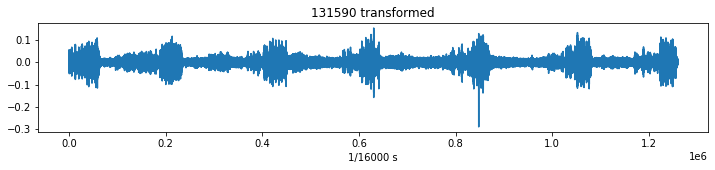

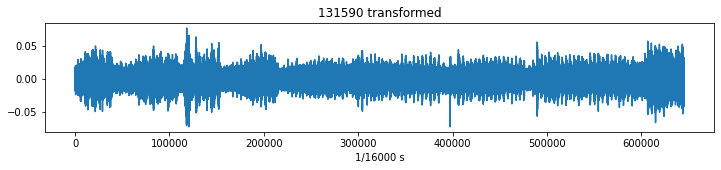

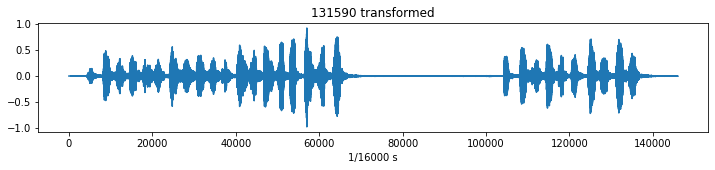

In [33]:

for k, v in waveforms_transformed.items():
    plt.figure(figsize=(12, 2))
    plt.plot(v)
    plt.xlabel('1/16000 s')
    plt.title(f"{row['id']} transformed")


In [41]:
Audio(waveforms[214657], rate=16000)

In [37]:
Audio(waveforms_transformed[214657], rate=16000)

In [43]:
Audio(waveforms[619362], rate=16000)

In [45]:
Audio(waveforms_transformed[619362], rate=16000)

In [42]:
Audio(waveforms_transformed[131590], rate=16000)

In [44]:
Audio(waveforms_transformed[131590], rate=16000)

The above shows that for the two cleaner examples, the preprocessing has managed to chop off the irrelevant sections. However, it's doesn't do as well in noisy sections. https://royalsocietypublishing.org/doi/10.1098/rspb.2012.2798 suggests that birds tend to sing> 2kHz, so if we also do noise removal using a high pass filter

In [14]:
from scipy.signal import butter,filtfilt
# high pass filter from https://towardsdatascience.com/audio-onset-detection-data-preparation-for-a-baseball-application-using-librosa-7f9735430c17
def butter_highpass(data,cutoff, fs, order=5):
    """
    Design a highpass filter.
    Args:
    - cutoff (float) : the cutoff frequency of the filter.
    - fs     (float) : the sampling rate.
    - order    (int) : order of the filter, by default defined to 5.
    """
    # calculate the Nyquist frequency
    nyq = 0.5 * fs
    # design filter
    high = cutoff / nyq
    b, a = butter(order, high, btype='high', analog=False)
    # returns the filter coefficients: numerator and denominator
    y = filtfilt(b, a, data)
    return y



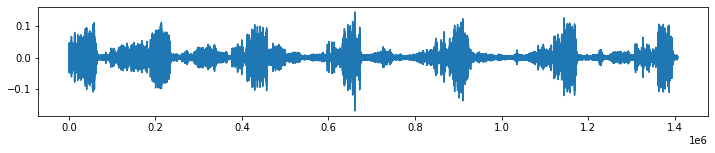

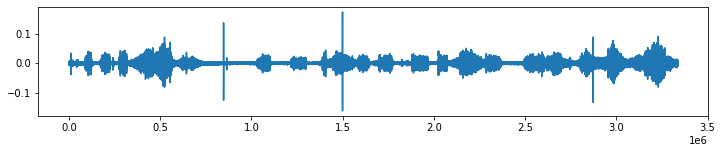

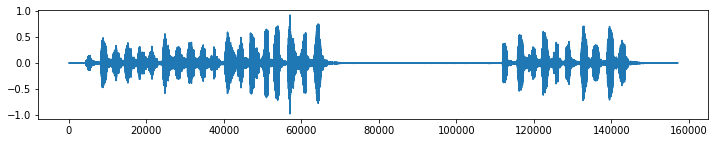

In [16]:


for id in examples['id'].values:
    x_f=butter_highpass(waveforms[id],2000, 16000, order=5)
    plt.figure(figsize=(12, 2))
    plt.plot(x_f)

In [52]:
Audio(x_f, rate=16000)

In [17]:
def load_wav_16k_mono(filename):
    """ read in a waveform file and convert to 16 kHz mono """
    file_contents = tf.io.read_file(filename)
    wav, sample_rate = tf.audio.decode_wav(
        file_contents,
        desired_channels=1)
    wav = tf.squeeze(wav, axis=-1)
    sample_rate = tf.cast(sample_rate, dtype=tf.int64)
    wav = tfio.audio.resample(wav, rate_in=sample_rate, rate_out=16000)
    return wav

def preprocess(filepath):
    waveform = load_wav_16k_mono(filepath)
    waveform = waveform.numpy()
    waveform = butter_highpass(waveform,2000, 16000, order=5)
    scores, embeddings, spectrogram = yamnet_base.model(waveform)
    waveform = extract_bird_sections(waveform, scores.numpy())
    return waveform

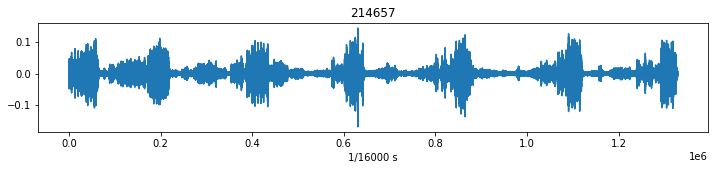

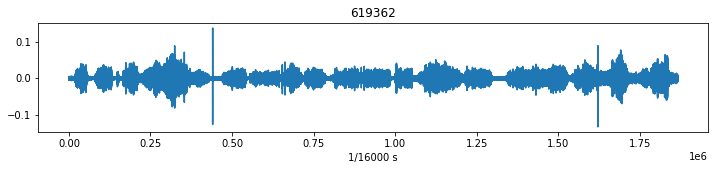

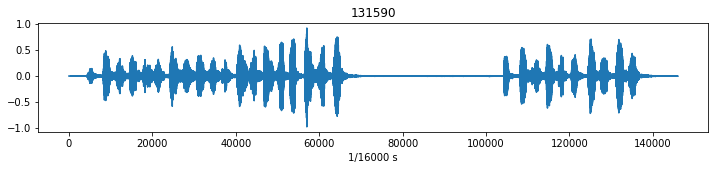

In [29]:
preprocessed_waveform2 = {}
for idx, row in examples.iterrows():
    waveform_processed = preprocess(row['filepath'])
    preprocessed_waveform2[row['id']] = waveform_processed
    plt.figure(figsize=(12, 2))
    plt.plot(waveform_processed)
    plt.xlabel('1/16000 s')
    plt.title(row['id'])

In [61]:
Audio(preprocessed_waveform2[619362], rate=16000)

In [60]:
Audio(waveforms[619362], rate=16000)

#### Clean all files corresponding to our sample:

In [20]:
output_folder = Path('/media/wwymak/Storage2/birdsong_dataset/xeno_canto_eu_cleaned_stage2')
output_folder.mkdir(exist_ok=True)

for label in birdsong_metadata_subset.label_string.unique():
    (output_folder/label).mkdir(exist_ok=True)

In [34]:
birdsong_metadata_subset = birdsong_metadata_subset.sample(frac=1.)
errors = []
for idx, row in tqdm(birdsong_metadata_subset.iterrows(), total=len(birdsong_metadata_subset)):
    waveform_processed = preprocess(row['filepath'])
    if len(waveform_processed) ==0:
        print(f"errro: {row['filepath']}")
        continue
    output_path = output_folder / row['label_string'] / f"{row['id']}.wav"
    sf.write(output_path, waveform_processed, samplerate=16000)
#     try:
#         sf.write(output_path, waveform_processed, samplerate=16000)
#     except Exception as e:
#         errors.append({'file': str(input_file), 'error': e})
#         if len(errors> 20):
#             raise 

 43%|████▎     | 834/1928 [04:20<02:50,  6.43it/s]

errro: /media/wwymak/Storage2/birdsong_dataset/xeno_canto_eu_cleaned/great_tit/377252.wav


 82%|████████▏ | 1575/1928 [08:22<01:21,  4.34it/s]

errro: /media/wwymak/Storage2/birdsong_dataset/xeno_canto_eu_cleaned/great_tit/617530.wav


100%|██████████| 1928/1928 [10:10<00:00,  3.16it/s]


#### Convert to tfrecord

Not strictly necessary, but useful to learn how to do, also hopefully make the data loading faster

a large chunk of code is adapted from https://keras.io/examples/keras_recipes/creating_tfrecords/#explore-one-sample-from-the-generated-tfrecord. Some things to note:
- to encode a numpy array, you need to use `tf.train.Feature(float_list=tf.train.FloatList(value=np_array))`
- `tf.io.TFRecordWriter` can't use pathlib paths, it need a string
- to read an example from tfrecord that has a numpy array as one of it's features, use `tf.io.VarLenFeature(tf.float32)` 

In [7]:
def audio_feature(waveform_np):
    """Returns a float_list from a audio np array"""
    return tf.train.Feature(float_list=tf.train.FloatList(value=waveform_np))

def bytes_feature(value):
    """Returns a bytes_list from a string / byte."""
    return tf.train.Feature(bytes_list=tf.train.BytesList(value=[value.encode()]))

def int64_feature(value):
    """Create a Int64List Feature

    Args:
        value: The value to store in the feature

    Returns:
        The FeatureEntry
    """
    return tf.train.Feature(int64_list=tf.train.Int64List(value=[value]))

def create_example(waveform, filepath, metadata):
    feature = {
        "audio": audio_feature(waveform),
        "filepath": bytes_feature(filepath),
        "section": int64_feature(metadata["section"]),
        "category_id": int64_feature(metadata["category_id"]),
        "audio_id": int64_feature(metadata["audio_id"]),
    }
    return tf.train.Example(features=tf.train.Features(feature=feature))

In [8]:
birdsong_metadata_subset.loc[:, "filepath"] = birdsong_metadata_subset.filepath.apply(lambda x: x.replace('/media/wwymak/Storage2/birdsong_dataset/xeno_canto_eu_cleaned', '/media/wwymak/Storage2/birdsong_dataset/xeno_canto_eu_cleaned_stage2'))
train_audio_paths, val_audio_paths, train_labels, val_labels = train_test_split(
        birdsong_metadata_subset["filepath"], birdsong_metadata_subset["label"], stratify=birdsong_metadata_subset["label"], test_size=0.2, random_state=101
    )


In [11]:
valid_train_paths = 0
invalid_train_paths = 0
valid_val_paths = 0
invalid_val_paths = 0
for p in train_audio_paths:
    if Path(p).exists():
        valid_train_paths += 1
    else:
        invalid_train_paths +=1
        
for p in val_audio_paths:
    if Path(p).exists():
        valid_val_paths += 1
    else:
        invalid_val_paths +=1
        
print(f"valid train paths: {valid_train_paths}")
print(f"invalid train paths: {invalid_train_paths}")
print(f"valid val paths: {valid_val_paths}")
print(f"invalid val paths: {invalid_val_paths}")

valid train paths: 1540
invalid train paths: 2
valid val paths: 386
invalid val paths: 0


In [12]:
tfrecords_dir = Path('/media/wwymak/Storage2/birdsong_dataset/xeno_canto_eu_cleaned_stage2_tfrecord')
tfrecords_dir.mkdir(exist_ok=True)

num_tfrecords_train = 1
num_tfrecords_val = 1

In [13]:
sample_rate = 16_000
seconds_per_chunk = 10

for tfrec_num in range(num_tfrecords_train):
    with tf.io.TFRecordWriter(
        str(tfrecords_dir / f"file_{tfrec_num}_train.tfrec")
    ) as writer:
        for audio_filepath, label in tqdm(list(zip(train_audio_paths.values.squeeze(), train_labels.values))):
            if not Path(audio_filepath).exists():
                print('error')
                continue
            metadata = dict(category_id=label,filepath=audio_filepath, audio_id=int(audio_filepath.split('/')[-1].replace('.wav', '')))
            audio_np = sf.read(audio_filepath)[0]
            num_chunks = np.ceil(len(audio_np)/ (sample_rate * seconds_per_chunk)).astype(int)
            for i in range(num_chunks):
                metadata['section'] = i
                
                audio_array = audio_np[i * (sample_rate * seconds_per_chunk): (i + 1) * (sample_rate * seconds_per_chunk) ]
                
                if len(audio_array) < (sample_rate * seconds_per_chunk):
                    pad_times = np.ceil((sample_rate * seconds_per_chunk) /len(audio_array)).astype(int)
                    audio_array = np.tile(audio_array, pad_times)
                    audio_array = audio_array[:(sample_rate * seconds_per_chunk)] 
                example = create_example(audio_array, audio_filepath, metadata)
                writer.write(example.SerializeToString())

 42%|████▏     | 650/1542 [01:49<01:17, 11.58it/s]

error


 50%|█████     | 775/1542 [02:15<01:22,  9.35it/s]

error


100%|██████████| 1542/1542 [04:28<00:00,  5.74it/s]


In [14]:
for tfrec_num in range(num_tfrecords_val):
    with tf.io.TFRecordWriter(
        str(tfrecords_dir / f"file_{tfrec_num}_val.tfrec")
    ) as writer:

        for audio_filepath, label in tqdm(list(zip(val_audio_paths.values.squeeze(), val_labels.values))):
            if not Path(audio_filepath).exists():
                continue
            metadata = dict(category_id=label,filepath=audio_filepath, audio_id=int(audio_filepath.split('/')[-1].replace('.wav', '')))
            audio_np = sf.read(audio_filepath)[0]
            num_chunks = np.ceil(len(audio_np)/ (sample_rate * seconds_per_chunk)).astype(int)
            
            for i in range(num_chunks):
                metadata['section'] = i
                    
                audio_array = audio_np[i * (sample_rate * seconds_per_chunk): (i + 1) * (sample_rate * seconds_per_chunk) ]
                
                if len(audio_array) < (sample_rate * seconds_per_chunk):
                    pad_times = np.ceil((sample_rate * seconds_per_chunk) /len(audio_array)).astype(int)
                    audio_array = np.tile(audio_array, pad_times)
                    audio_array = audio_array[:(sample_rate * seconds_per_chunk)]
                example = create_example(audio_array, audio_filepath, metadata)
                writer.write(example.SerializeToString())

100%|██████████| 386/386 [01:07<00:00,  5.75it/s]


In [15]:
def parse_tfrecord_fn(example):
    feature_description = {
        "audio": tf.io.VarLenFeature(tf.float32),
        "filepath": tf.io.FixedLenFeature([], tf.string),
        "category_id": tf.io.FixedLenFeature([], tf.int64),
        "audio_id": tf.io.FixedLenFeature([], tf.int64),
        "section": tf.io.FixedLenFeature([], tf.int64),
    }

    example = tf.io.parse_single_example(example, feature_description)
    example['audio'] = tf.sparse.to_dense(example['audio'])
    return example

audio_id: 178996
category_id: 1
filepath: b'/media/wwymak/Storage2/birdsong_dataset/xeno_canto_eu_cleaned_stage2/great_tit/178996.wav'
section: 0
waveform shape: (160000,)
waveform type: <dtype: 'float32'>


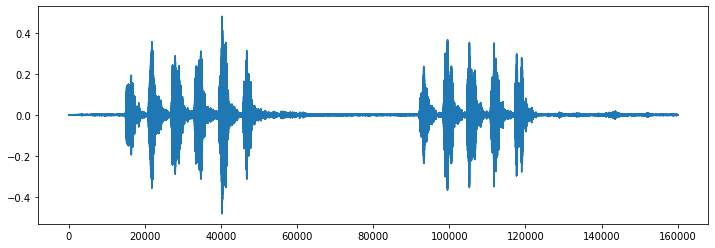

In [16]:
# read out dataset to grab one random sample
tfrecords_dir = Path('/media/wwymak/Storage2/birdsong_dataset/xeno_canto_eu_cleaned_stage2_tfrecord')
raw_dataset = tf.data.TFRecordDataset(str(tfrecords_dir / f"file_0_train.tfrec"))
parsed_dataset = raw_dataset.map(parse_tfrecord_fn)
sample = parsed_dataset.take(1)
sample_wav = None
for features in sample:
    for key in features.keys():
        if key != "audio":
            print(f"{key}: {features[key]}")
#     sample_wav = tf.sparse.to_dense(features['audio'])
    sample_wav = features['audio']
    print(f"waveform shape: {features['audio'].shape}")
    print(f"waveform type: {features['audio'].dtype}")
    plt.figure(figsize=(12, 4))
    plt.plot(sample_wav.numpy())


#### Modelling-- spectrogram

In [19]:
sample_rate = 16_000
seconds_per_chunk = 10

In [41]:
def spec_augment(waveform):
    spectrogram = tfio.experimental.audio.spectrogram(
        waveform, nfft=512, window=512, stride=256)
    mel_spectrogram = tfio.experimental.audio.melscale(
        spectrogram, rate=sample_rate, mels=128, fmin=2000, fmax=sample_rate//2)
    dbscale_mel_spectrogram = tfio.experimental.audio.dbscale(
        mel_spectrogram, top_db=80)
    freq_mask = tfio.experimental.audio.time_mask(dbscale_mel_spectrogram, param=10)
    print('here')
    return dbscale_mel_spectrogram


<dtype: 'float32'>
(625, 128)


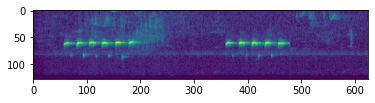

In [37]:
augment_example = spec_augment(sample_wav)
print(augment_example.shape)
plt.imshow(augment_example.numpy().T)

In [20]:
def get_mfcc(waveform):
    spectrogram = tfio.experimental.audio.spectrogram(
        waveform, nfft=512, window=512, stride=256)
    mel_spectrogram = tfio.experimental.audio.melscale(
        spectrogram, rate=sample_rate, mels=128, fmin=2000, fmax=sample_rate//2)
    dbscale_mel_spectrogram = tfio.experimental.audio.dbscale(
        mel_spectrogram, top_db=80)
    return tf.expand_dims(dbscale_mel_spectrogram, axis=2)

In [21]:


def make_model(num_classes):
    inputs = tf.keras.Input(shape=(sample_rate * seconds_per_chunk,))
    x = tf.keras.layers.Lambda(lambda x: get_mfcc(x), output_shape=(625, 128, 1))(inputs)
    # Image augmentation block

#     x = tf.keras.layers.experimental.preprocessing.Normalization()(spectrogram)
    # Entry block
#     x = layers.experimental.preprocessing.Rescaling(1.0 / 255)(x)
    x = tf.keras.layers.Conv2D(32, 3, strides=2, padding="same")(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.Activation("relu")(x)

    x = tf.keras.layers.Conv2D(64, 3, padding="same")(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.Activation("relu")(x)

#     previous_block_activation = x  # Set aside residual

#     for size in [128, 256, 512, 728]:
#         x = tf.keras.layers.Activation("relu")(x)
#         x = tf.keras.layers.SeparableConv2D(size, 3, padding="same")(x)
#         x = tf.keras.layers.BatchNormalization()(x)

#         x = tf.keras.layers.Activation("relu")(x)
#         x = tf.keras.layers.SeparableConv2D(size, 3, padding="same")(x)
#         x = tf.keras.layers.BatchNormalization()(x)

#         x = tf.keras.layers.MaxPooling2D(3, strides=2, padding="same")(x)

#         # Project residual
#         residual = tf.keras.layers.Conv2D(size, 1, strides=2, padding="same")(
#             previous_block_activation
#         )
#         x = tf.keras.layers.add([x, residual])  # Add back residual
#         previous_block_activation = x  # Set aside next residual

    x = tf.keras.layers.SeparableConv2D(128, 3, padding="same")(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.Activation("relu")(x)

    x = tf.keras.layers.GlobalAveragePooling2D()(x)
#     if num_classes == 2:
#         activation = "sigmoid"
#         units = 1
#     else:
    activation = "softmax"
    units = num_classes

    x = tf.keras.layers.Dropout(0.5)(x)
    outputs = tf.keras.layers.Dense(units)(x)
    return tf.keras.Model(inputs, outputs)

In [22]:
# model = make_model(num_classes=2)
# model.summary()

In [24]:
batch_size = 128
epochs = 50
steps_per_epoch = 50
AUTOTUNE = tf.data.experimental.AUTOTUNE

def parse_tfrecord(example):
    feature_description = {
        "audio": tf.io.VarLenFeature(tf.float32),
        "category_id": tf.io.FixedLenFeature([], tf.int64),
    }

    example = tf.io.parse_single_example(example, feature_description)
    example['audio'] = tf.sparse.to_dense(example['audio'])
    return example

def prepare_sample(features):
    audio = get_mfcc(features['audio']) 
    return audio, features['category_id']

def get_dataset(filenames, batch_size):
    dataset = (
        tf.data.TFRecordDataset(filenames, num_parallel_reads=AUTOTUNE)
        .map(parse_tfrecord, num_parallel_calls=AUTOTUNE)
        .map(prepare_sample, num_parallel_calls=AUTOTUNE)
        .shuffle(batch_size * 10)
        .batch(batch_size)
        .prefetch(AUTOTUNE)
    )
    return dataset

tfrecords_dir = Path('/media/wwymak/Storage2/birdsong_dataset/xeno_canto_eu_cleaned_stage2_tfrecord')
train_filenames = tf.io.gfile.glob(f"{str(tfrecords_dir)}/*_train.tfrec")
valid_filenames = tf.io.gfile.glob(f"{str(tfrecords_dir)}/*_val.tfrec")

train_dataset = get_dataset(train_filenames, batch_size)
valid_dataset = get_dataset(valid_filenames, batch_size)





In [26]:
norm_layer = tf.keras.layers.experimental.preprocessing.Normalization()
norm_layer.adapt(train_dataset.map(lambda x, _: x))

model = tf.keras.models.Sequential([
    tf.keras.layers.Input(shape=(625, 128, 1)),
    tf.keras.layers.experimental.preprocessing.Resizing(128, 128), 
    norm_layer,
    tf.keras.layers.Conv2D(32, 3, activation='relu'),
    tf.keras.layers.Conv2D(64, 3, activation='relu'),
    tf.keras.layers.MaxPooling2D(),
    tf.keras.layers.Dropout(0.25),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(128, activation='relu'),
    tf.keras.layers.Dropout(0.5),
    tf.keras.layers.Dense(2),
])

model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
resizing (Resizing)          (None, 128, 128, 1)       0         
_________________________________________________________________
normalization (Normalization (None, 128, 128, 1)       3         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 126, 126, 32)      320       
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 124, 124, 64)      18496     
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 62, 62, 64)        0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 62, 62, 64)        0         
_________________________________________________________________
flatten (Flatten)            (None, 246016)            0

In [27]:
callbacks = [
    tf.keras.callbacks.ModelCheckpoint(
        filepath="models/spectrogram_2birds",
        save_best_only=True,  # Only save a model if `val_loss` has improved.
        monitor="val_loss",
        verbose=1,
    ),
    tf.keras.callbacks.TensorBoard(
        log_dir="./logs",
    )  # How often to write logs (default: once per epoch)
]
model.compile(
    optimizer=tf.keras.optimizers.Adam(),
    loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
    metrics=['accuracy'],
)

history = model.fit(
    train_dataset, 
    validation_data=valid_dataset,  
    epochs=50,
    callbacks=callbacks,
)

Epoch 1/50
      1/Unknown - 0s 516us/step - loss: 0.7173 - accuracy: 0.4609WARNING:tensorflow:From /home/wwymak/anaconda3/envs/birdsong_recognition/lib/python3.8/site-packages/tensorflow/python/ops/summary_ops_v2.py:1277: stop (from tensorflow.python.eager.profiler) is deprecated and will be removed after 2020-07-01.
Instructions for updating:
use `tf.profiler.experimental.stop` instead.
      2/Unknown - 0s 55ms/step - loss: 29.0926 - accuracy: 0.5156WARNING:tensorflow:Callbacks method `on_train_batch_end` is slow compared to the batch time (batch time: 0.0284s vs `on_train_batch_end` time: 0.0816s). Check your callbacks.
     78/Unknown - 16s 210ms/step - loss: 1.6447 - accuracy: 0.6641
Epoch 00001: val_loss improved from inf to 0.44269, saving model to models/spectrogram_2birds
Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates 

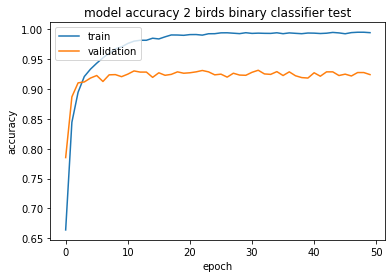

In [30]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])  
plt.title('model accuracy 2 birds binary classifier test')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()
# summarize history for loss
# plt.plot(history.history['loss'])
# plt.plot(history.history['val_loss']) #RAISE ERROR
# plt.title('model loss')
# plt.ylabel('loss')
# plt.xlabel('epoch')
# plt.legend(['train', 'test'], loc='upper left')
# plt.show()

In [43]:
# correct version of freq mask as per https://github.com/tensorflow/io/pull/1170
def freq_mask(input, param, name=None):
    """
    Apply masking to a spectrogram in the freq domain.
    Args:
      input: An audio spectogram.
      param: Parameter of freq masking.
      name: A name for the operation (optional).
    Returns:
      A tensor of spectrogram.
    """
    input = tf.convert_to_tensor(input)
    # TODO: Support audio with channel > 1.
    freq_max = tf.shape(input)[1]
    f = tf.random.uniform(shape=(), minval=0, maxval=param, dtype=tf.dtypes.int32)
    f0 = tf.random.uniform(
        shape=(), minval=0, maxval=freq_max - f, dtype=tf.dtypes.int32
    )
    indices = tf.reshape(tf.range(freq_max), (1, -1))
    condition = tf.math.logical_and(
        tf.math.greater_equal(indices, f0), tf.math.less(indices, f0 + f)
    )
    return tf.where(condition, tf.cast(0, input.dtype), input)


def prepare_sample_specaugment(features):
    audio = get_mfcc(features['audio']) 
    augmented = freq_mask(audio, 10)
    return augmented, features['category_id']

def get_dataset_augment(filenames, batch_size):
    dataset = (
        tf.data.TFRecordDataset(filenames, num_parallel_reads=AUTOTUNE)
        .map(parse_tfrecord, num_parallel_calls=AUTOTUNE)
        .map(prepare_sample_specaugment, num_parallel_calls=AUTOTUNE)
        .shuffle(batch_size * 10)
        .batch(batch_size)
        .prefetch(AUTOTUNE)
    )
    return dataset

train_dataset_augment = get_dataset_augment(train_filenames, batch_size)
valid_dataset_augment = get_dataset_augment(valid_filenames, batch_size)
